<!--  -->
# Preprocessing - Joint Embedding with MultiVI
Michael Sterr

2022-08-29 16:47:56      


# Setup

Run following scripts before:
 * 6-1_scMultiome_FVF-Gut_Multiome-WNN-Embedding-Initial-Clustering_v1
 * 06-1_scRNA-seq_Gut_Wnt-PCP_Böttcher-et-al_Initail-Clustering-and-Annotatoin_markedDoublets_CD1-3_v1

In [1]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:85% !important; }</style>"))

/tmp/ipykernel_2303897/495279268.py:1: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display, HTML


In [2]:
# General
import scipy as sci
import numpy as np
import pandas as pd
import logging
import time
import datetime
import pickle
from itertools import chain
import h5py
import scipy.sparse as sparse
import anndata as ad
import gc
import scipy.stats as stats
import torch

# Plotting
import matplotlib.pyplot as plt
import matplotlib as mpl
import matplotlib.colors as mcolors
from matplotlib import rcParams
from matplotlib.pyplot import rc_context
from matplotlib import cm
import seaborn as sb

# Analysis
import scanpy as sc
import scvi
import muon as mu
from muon import atac as ac # Import a module with ATAC-seq-related functions

#import scvelo as scv
#import cellrank as cr

/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/scvi/_settings.py:63: UserWarning: Since v1.0.0, scvi-tools no longer uses a random seed by default. Run `scvi.settings.seed = 0` to reproduce results from previous versions.
  self.seed = seed
/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/scvi/_settings.py:70: UserWarning: Setting `dl_pin_memory_gpu_training` is deprecated in v1.0 and will be removed in v1.1. Please pass in `pin_memory` to the data loaders instead.
  self.dl_pin_memory_gpu_training = (
/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit fo

In [3]:
# Settings

## SCVI
scvi.settings.seed = 42 #123456789
print("Last run with scvi-tools version:", scvi.__version__)

## Scanpy settings
sc.settings.verbosity = 3
sc.logging.print_header()
sc.logging.print_versions()


Global seed set to 42


Last run with scvi-tools version: 1.0.1
scanpy==1.9.3 anndata==0.9.1 umap==0.5.3 numpy==1.23.5 scipy==1.10.1 pandas==2.0.2 scikit-learn==1.2.2 statsmodels==0.14.0 python-igraph==0.10.4 pynndescent==0.5.10
-----
anndata     0.9.1
scanpy      1.9.3
-----
PIL                                         9.4.0
aa8f2297d25b4dc6fd3d98411eb3ba53823c4f42    NA
absl                                        NA
aiohttp                                     3.8.4
aiosignal                                   1.3.1
anyio                                       NA
appdirs                                     1.4.4
arrow                                       1.2.3
asttokens                                   NA
astunparse                                  1.6.3
async_timeout                               4.0.2
attr                                        23.1.0
babel                                       2.12.1
backcall                                    0.2.0
bs4                                         4.12.2
certif

In [4]:
# Plot settings
%matplotlib inline

## Directory
sc.settings.figdir='/home/michi/Projects/scMultiome_FVF_Crypts_P21021_Notebooks/Figures'

## Plotting parameters
rcParams['figure.figsize']=(20,20) #rescale figures
#sc.set_figure_params(scanpy=True, frameon=False, vector_friendly=False, color_map='tab10' ,transparent=True, dpi=150, dpi_save=300)
sc.set_figure_params(scanpy=True, frameon=False, vector_friendly=False ,transparent=True, dpi=150, dpi_save=300)

## Font
rcParams['font.family'] = 'sans-serif'
rcParams['font.sans-serif'] = ['Source Sans 3']

## Grid & Ticks
rcParams['grid.alpha'] = 0
rcParams['xtick.bottom'] = True
rcParams['ytick.left'] = True

## Embed font
plt.rc('pdf', fonttype=42)

## Define new default settings
plt.rcParamsDefault = plt.rcParams

In [5]:
# Color maps4
exec(open("/home/michi/Software/viscm/maps/michi_wt_rd_4.py").read())
exec(open("/home/michi/Software/viscm/maps/dense.py").read())
exec(open("/home/michi/Software/viscm/maps/turbo.py").read())
exec(open("/home/michi/Software/viscm/maps/michi_bk_bl_gn_yl.py").read())
exec(open("/home/michi/Software/viscm/maps/michi_bk_rd.py").read())
exec(open("/home/michi/Software/viscm/maps/michi_bk_rd_or.py").read())
exec(open("/home/michi/Software/viscm/maps/michi_bk_rd_or_2.py").read())
exec(open("/home/michi/Software/viscm/maps/michi_bk_rd_yl.py").read())
exec(open("/home/michi/Software/viscm/maps/michi_bk_rd_yl_2.py").read())
exec(open("/home/michi/Software/viscm/maps/michi_bk_rd_yl_3.py").read())
exec(open("/home/michi/Software/viscm/maps/michi_bk_rd_yl_4.py").read())
exec(open("/home/michi/Software/viscm/maps/michi_bk_bl_gn.py").read())

ch_YlRd=sb.cubehelix_palette(100, start=.7, rot=.25, gamma=0.6, hue=2, light=1, dark=0.05, as_cmap=True)
ch_Bl=sb.cubehelix_palette(100, start=2.65, rot=0, gamma=0.8, hue=1.8, light=1, dark=0, as_cmap=True)
ch_Bl2=sb.cubehelix_palette(100, start=2.75, rot=-.12, gamma=0.8, hue=1.8, light=1, dark=0, as_cmap=True)
ch_Bl2_2=sb.cubehelix_palette(100, start=2.75, rot=-.12, gamma=0.8, hue=1.8, light=0.9, dark=0, as_cmap=True) #

cm_PuGy=ListedColormap(['#ededed', '#ecebec', '#eae9eb', '#e9e7eb', '#e8e5ea', '#e7e4e9', '#e5e2e8', '#e4e0e7', '#e3dee6', '#e1dce6', '#e0dae5', '#dfd8e4', '#ded7e3', '#dcd5e2', '#dbd3e1', '#dad1e1', '#d8cfe0', '#d7cddf', '#d6cbde', '#d5cadd', '#d3c8dc', '#d2c6dc', '#d1c4db', '#cfc2da', '#cec0d9', '#cdbfd8', '#ccbdd7', '#cabbd7', '#c9b9d6', '#c8b7d5', '#c6b5d4', '#c5b4d3', '#c4b2d2', '#c3b0d2', '#c1aed1', '#c0acd0', '#bfabcf', '#bda9ce', '#bca7cd', '#bba5cd', '#b9a3cc', '#b8a2cb', '#b7a0ca', '#b69ec9', '#b49cc8', '#b39ac8', '#b299c7', '#b097c6', '#af95c5', '#ae93c4', '#ac92c3', '#ab90c2', '#aa8ec2', '#a88cc1', '#a78bc0', '#a689bf', '#a487be', '#a385bd', '#a283bd', '#a182bc', '#9f80bb', '#9e7eba', '#9d7db9', '#9b7bb8', '#9a79b8', '#9977b7', '#9776b6', '#9674b5', '#9572b4', '#9370b3', '#926fb3', '#916db2', '#8f6bb1', '#8e69b0', '#8d68af', '#8b66ae', '#8a64ad', '#8863ad', '#8761ac', '#865fab', '#845daa', '#835ca9', '#825aa8', '#8058a8', '#7f57a7', '#7e55a6', '#7c53a5', '#7b52a4', '#7950a3', '#784ea2', '#774ca2', '#754ba1', '#7449a0', '#72479f', '#71469e', '#70449d', '#6e429d', '#6d409c', '#6b3f9b', '#6a3d9a'])
cm_YlBl=ListedColormap(['#ff7f0e', '#fe7f13', '#fc7f17', '#fb7f1a', '#fa7f1d', '#f87f20', '#f77f23', '#f57f26', '#f47f28', '#f37f2a', '#f17f2d', '#f07f2f', '#ee7f31', '#ed7f33', '#ec7f35', '#ea7f37', '#e97e39', '#e77e3b', '#e67e3d', '#e47e3e', '#e37e40', '#e27e42', '#e07e44', '#df7e45', '#dd7e47', '#dc7e49', '#da7e4a', '#d97e4c', '#d77e4e', '#d67e4f', '#d47e51', '#d37e52', '#d17e54', '#d07e55', '#ce7d57', '#cd7d59', '#cb7d5a', '#ca7d5c', '#c87d5d', '#c67d5f', '#c57d60', '#c37d62', '#c27d63', '#c07d64', '#be7d66', '#bd7d67', '#bb7d69', '#b97c6a', '#b87c6c', '#b67c6d', '#b47c6f', '#b37c70', '#b17c71', '#af7c73', '#ad7c74', '#ac7c76', '#aa7c77', '#a87c79', '#a67c7a', '#a47b7b', '#a37b7d', '#a17b7e', '#9f7b80', '#9d7b81', '#9b7b82', '#997b84', '#977b85', '#957b86', '#937b88', '#917a89', '#8e7a8b', '#8c7a8c', '#8a7a8d', '#887a8f', '#867a90', '#837a92', '#817a93', '#7e7a94', '#7c7996', '#797997', '#777998', '#74799a', '#71799b', '#6f799d', '#6c799e', '#69799f', '#6679a1', '#6278a2', '#5f78a3', '#5c78a5', '#5878a6', '#5478a8', '#5078a9', '#4c78aa', '#4878ac', '#4378ad', '#3d77ae', '#3777b0', '#3177b1', '#2977b3', '#1f77b4'])
cm_GnBl=ListedColormap(['#ffffff', '#fbfdfa', '#f7fcf6', '#f3faf2', '#eff8ef', '#ebf6eb', '#e7f4e8', '#e3f3e5', '#dff1e2', '#dbefde', '#d8eddb', '#d4ebd8', '#d0e9d5', '#cce7d2', '#c8e5cf', '#c5e3cf', '#c2e1ce', '#bfdfce', '#bcdccd', '#b9dacd', '#b6d8cd', '#b3d5cc', '#b0d3cb', '#add1cb', '#aaceca', '#a8ccca', '#a5cac9', '#a2c7c8', '#9fc5c8', '#9cc3c7', '#99c1c6', '#97bec5', '#94bcc5', '#91bac4', '#8eb7c3', '#8cb5c2', '#89b3c1', '#86b1c1', '#84aec0', '#81acbf', '#7eaabe', '#7ca7bd', '#79a5bc', '#77a3bb', '#74a1ba', '#729eb9', '#6f9cb8', '#6d9ab7', '#6a98b5', '#6895b4', '#6593b3', '#6391b2', '#608fb1', '#5e8db0', '#5c8aae', '#5988ad', '#5786ac', '#5584ab', '#5281a9', '#507fa8', '#4e7da7', '#4b7ba5', '#4979a4', '#4776a3', '#4574a1', '#4372a0', '#40709e', '#3e6e9d', '#3c6b9c', '#3a699a', '#386799', '#366597', '#346396', '#326194', '#305e92', '#2e5c91', '#2c5a8f', '#2a588e', '#28568c', '#26548b', '#245289', '#225087', '#204d86', '#1e4b84', '#1c4982', '#1a4781', '#18457f', '#16437d', '#14417b', '#123f7a', '#103d78', '#0e3b76', '#0c3974', '#0a3772', '#083571', '#06336f', '#04316d', '#032f6b', '#012d69', '#002a67'])
cm_Bl=ListedColormap(['#ffffff', '#fbfdfc', '#f7fbfb', '#f4f9f9', '#f0f7f8', '#ecf5f7', '#e9f3f5', '#e5f1f4', '#e2eff3', '#deedf2', '#daebf1', '#d7e9f0', '#d3e7ef', '#cfe5ee', '#cce3ed', '#c8e1ec', '#c4dfeb', '#c1ddea', '#bddbe9', '#b9d9e8', '#b6d7e7', '#b2d5e6', '#aed3e5', '#abd1e4', '#a7cfe3', '#a3cde2', '#9fcbe1', '#9cc8e0', '#9ac6df', '#97c4de', '#95c2dd', '#92bfdc', '#90bddb', '#8ebbda', '#8bb8d8', '#89b6d7', '#86b4d6', '#84b2d5', '#82afd4', '#7fadd2', '#7dabd1', '#7ba9d0', '#78a6cf', '#76a4cd', '#73a2cc', '#71a0cb', '#6f9ec9', '#6d9bc8', '#6a99c6', '#6897c5', '#6695c4', '#6393c2', '#6190c1', '#5f8ebf', '#5d8cbe', '#5a8abc', '#5888bb', '#5686b9', '#5483b8', '#5281b6', '#4f7fb5', '#4d7db3', '#4b7bb2', '#4979b0', '#4777ae', '#4575ad', '#4272ab', '#4070a9', '#3e6ea8', '#3c6ca6', '#3a6aa4', '#3868a3', '#3666a1', '#34649f', '#32629d', '#30609b', '#2e5e9a', '#2c5c98', '#2a5a96', '#285794', '#265592', '#245390', '#23518e', '#214f8c', '#1f4d8a', '#1d4b88', '#1b4986', '#1a4784', '#184582', '#164380', '#14417e', '#133f7c', '#113e7a', '#103c78', '#0e3a76', '#0d3874', '#0b3672', '#0a346f', '#09326d', '#08306b'])
cm_BlBk=ListedColormap(['#ffffff', '#fbfcfe', '#f6fafd', '#f2f7fc', '#eef4fa', '#eaf1f9', '#e6eff8', '#e1ecf6', '#dde9f5', '#d9e7f4', '#d5e4f2', '#d1e1f1', '#cddff0', '#c9dcee', '#c4d9ed', '#c0d7ec', '#bcd4ea', '#b8d1e9', '#b4cfe8', '#afcce6', '#abc9e5', '#a7c7e3', '#a3c4e2', '#9ec2e1', '#9abfdf', '#96bcde', '#91badc', '#8db7db', '#89b5da', '#84b2d8', '#80b0d7', '#7badd5', '#76aad4', '#72a8d2', '#6da5d1', '#68a3d0', '#63a0ce', '#5e9ecd', '#589bcb', '#5399ca', '#4d96c9', '#4794c7', '#4291c5', '#408ec3', '#3f8cc0', '#3e89bd', '#3c86bb', '#3b83b8', '#3a80b5', '#397db3', '#377bb0', '#3678ad', '#3575aa', '#3472a7', '#3270a4', '#316da2', '#306a9f', '#2f679c', '#2e6599', '#2d6296', '#2c5f93', '#2a5d90', '#295a8d', '#28588a', '#275586', '#265283', '#255080', '#244d7d', '#234b7a', '#234876', '#224673', '#214470', '#20416d', '#1f3f69', '#1e3c66', '#1e3a62', '#1d385f', '#1c355c', '#1b3358', '#1b3155', '#1a2e51', '#192c4d', '#182a4a', '#182846', '#172642', '#16233f', '#16213b', '#151f37', '#141d34', '#131b30', '#12192c', '#121728', '#111524', '#101320', '#0e101c', '#0c0d19', '#090a14', '#06070f', '#030308', '#000000'])
cm_CatBl=mcolors.ListedColormap(['#ffffff', '#fdfdfe', '#fbfcfd', '#f9fbfc', '#f7f9fb', '#f5f8fa', '#f3f6f9', '#f1f5f8', '#eff3f7', '#edf2f6', '#ebf0f5', '#e9eff4', '#e7edf3', '#e6ecf2', '#e4eaf1', '#e2e9f0', '#e0e7f0', '#dee6ef', '#dce4ee', '#dae3ed', '#d8e1ec', '#d6e0eb', '#d4deea', '#d2dde9', '#d0dbe8', '#cedae7', '#ccd9e6', '#cad7e5', '#c8d6e4', '#c6d4e3', '#c4d3e2', '#c2d1e1', '#c0d0e0', '#bfcedf', '#bdcdde', '#bbccdd', '#b9cadc', '#b7c9db', '#b5c7da', '#b3c6d9', '#b1c4d8', '#afc3d8', '#adc2d7', '#abc0d6', '#a9bfd5', '#a7bdd4', '#a5bcd3', '#a3bad2', '#a1b9d1', '#9fb8d0', '#9db6cf', '#9bb5ce', '#99b3cd', '#97b2cc', '#95b1cb', '#93afca', '#92aec9', '#90acc8', '#8eabc7', '#8caac6', '#8aa8c5', '#88a7c5', '#86a5c4', '#84a4c3', '#82a3c2', '#80a1c1', '#7ea0c0', '#7c9fbf', '#7a9dbe', '#779cbd', '#759abc', '#7399bb', '#7198ba', '#6f96b9', '#6d95b8', '#6b94b7', '#6992b6', '#6791b5', '#6590b5', '#638eb4', '#608db3', '#5e8cb2', '#5c8ab1', '#5a89b0', '#5888af', '#5586ae', '#5385ad', '#5184ac', '#4f82ab', '#4c81aa', '#4a80a9', '#477ea8', '#457da7', '#427ca7', '#407aa6', '#3d79a5', '#3b78a4', '#3877a3', '#3575a2', '#3274a1'])
cm_CatYl=mcolors.ListedColormap(['#ffffff', '#fffefd', '#fffcfb', '#fffbf8', '#fffaf6', '#fff9f4', '#fff7f2', '#fff6f0', '#fff5ee', '#fff3ec', '#fff2e9', '#fff1e7', '#ffefe5', '#ffeee3', '#ffede1', '#ffecde', '#ffeadc', '#ffe9da', '#ffe8d8', '#ffe6d6', '#ffe5d4', '#ffe4d1', '#ffe2cf', '#ffe1cd', '#ffe0cb', '#ffdec9', '#ffddc6', '#fedcc4', '#fedbc2', '#fed9c0', '#fed8be', '#fed7bc', '#fed5ba', '#fdd4b8', '#fdd3b5', '#fdd2b3', '#fdd0b1', '#fdcfaf', '#fccead', '#fcccab', '#fccba9', '#fccaa7', '#fbc9a5', '#fbc7a2', '#fbc6a0', '#fbc59e', '#fac39c', '#fac29a', '#fac198', '#f9c096', '#f9be94', '#f9bd92', '#f8bc90', '#f8bb8e', '#f8b98c', '#f7b889', '#f7b787', '#f6b685', '#f6b483', '#f6b381', '#f5b27f', '#f5b07d', '#f5af7b', '#f4ae79', '#f4ad77', '#f3ab75', '#f3aa73', '#f2a971', '#f2a86f', '#f1a66d', '#f1a56b', '#f1a468', '#f0a366', '#f0a164', '#efa062', '#ef9f60', '#ee9e5e', '#ee9c5c', '#ed9b5a', '#ed9a58', '#ec9956', '#ec9754', '#eb9652', '#ea9550', '#ea944d', '#e9924b', '#e99149', '#e89047', '#e88f45', '#e78d43', '#e68c41', '#e68b3e', '#e58a3c', '#e5883a', '#e48738', '#e38635', '#e38533', '#e28331', '#e2822e', '#e1812c'])

In [6]:
def plot_composition(adata, 
x_key=None, 
y_key=None, 
x_labels = None,
y_labels = None,
y_colors = None,
title=None,                     
width = 0.85,       # the width of the bars: can also be len(x) sequence
x_rotation = 0,
y_lim_offset = 2.5,
x_lim_offset = 0.45,
figsize= (6, 4)):
    with rc_context({'figure.figsize': figsize}): #rcParams['figure.figsize']=(6,4)
        if (x_labels == None):
            x_labels = list(adata.obs[x_key].cat.categories)
        
        if (y_labels == None):
            y_labels = list(adata.obs[y_key].cat.categories)
        
        if (y_colors == None):
            y_colors = list(adata.uns[y_key + '_colors'])
            
        dic = {'x_labels':x_labels}
        
        for y_label in y_labels:
            x_values = []
            for x_label in x_labels:
                x_value = adata.obs[y_key][adata.obs[x_key]==x_label].value_counts()[y_label]/adata.obs[y_key][adata.obs[x_key]==x_label].value_counts().sum()*100
                x_values.append(x_value)
            dic[y_label] = x_values
        
        df = pd.DataFrame(data = dic)

        ax = df.plot(x='x_labels', kind='bar', stacked=True, width=width, edgecolor='0', linewidth=0.5, color=y_colors)

        ax.set_ylabel('%')
        ax.set_xlabel('')
        if (title == None):
            ax.set_title(y_key + ' by ' + x_key)
        else:
            ax.set_title(title)
            
        ax.axes.set_xticklabels(labels=x_labels, rotation=x_rotation)
        ax.legend(bbox_to_anchor=(1, .5),loc='center left', edgecolor='1')

        plt.ylim([-y_lim_offset,100+y_lim_offset])
        plt.xlim([-1+x_lim_offset,len(x_labels)-x_lim_offset])

        plt.show()
        
    return(df)


# Read Multiome Data

In [7]:
mdata = mu.read('/home/michi/Projects/scMultiome_Mouse-Islets_NVF_E14-E16_Notebooks/Files/scMultiome_Mouse-Islets_NVF_E14-E16_mdata_markedDoublets_mergedPeaks_normalized.h5mu')

In [8]:
mdata

MuData object with n_obs × n_vars = 28482 × 271918
  obs:	'sample', 'name', 'stage', 'stage_num', 'int_id', 'seq_id_gex_id', 'seq_id_atac', 'reporter', 'experiment_batch', 'sequencing_batch', 'final_doublets', 'final_doublets_cat', 'doublet_calls', 'batch'
  var:	'feature_types', 'genome', 'n_counts', 'highly_variable'
  2 modalities
    rna:	28482 x 20242
      obs:	'sample', 'name', 'stage', 'stage_num', 'int_id', 'seq_id_gex_id', 'seq_id_atac', 'reporter', 'experiment_batch', 'sequencing_batch', 'n_counts', 'log_counts', 'n_counts_rank', 'n_genes', 'log_genes', 'mt_frac', 'rp_frac', 'ambi_frac', 'final_doublets', 'final_doublets_cat', 'doublet_calls', 'batch', 'size_factors', 'leiden'
      var:	'gene_ids', 'feature_types', 'genome', 'interval', 'ambient_genes_E14_5-0', 'is_ambient_E14_5-0', 'n_counts-0', 'n_counts-1', 'ambient_genes_E15_5-1', 'is_ambient_E15_5-1', 'n_counts-2', 'ambient_genes_NVF_E15-5_Rep2-2', 'is_ambient_NVF_E15-5_Rep2-2', 'n_counts-3', 'ambient_genes_NVF_E16-5_Rep1-3', 'is_ambient_NVF_E16-5_Rep1-3', 'is_ambient', 'n_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'sct.detection_rate', 'sct.gmean', 'sct.variance', 'sct.residual_variance', 'sct.variable'
      uns:	'final_doublets_cat_colors', 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'sample_colors', 'umap'
      obsm:	'X_pca', 'X_umap'
      varm:	'PCs'
      layers:	'ambiguous', 'log_raw_counts', 'matrix', 'raw_counts', 'scran_counts', 'sct_counts', 'sct_logcounts', 'sct_scale_data', 'spliced', 'unspliced'
      obsp:	'connectivities', 'distances'
    atac:	28482 x 251676
      obs:	'sample', 'name', 'stage', 'stage_num', 'int_id', 'seq_id_gex_id', 'seq_id_atac', 'reporter', 'experiment_batch', 'sequencing_batch', 'final_doublets', 'final_doublets_cat', 'doublet_calls', 'batch', 'n_counts_ATAC', 'log_counts_ATAC', 'n_counts_rank_ATAC', 'n_peaks_ATAC', 'log_peaks_ATAC', 'nucleosome_signal', 'tss_score', 'leiden'
      var:	'feature_types', 'modality', 'genome', 'n_counts', 'highly_variable', 'percentile'
      uns:	'files', 'final_doublets_cat_colors', 'leiden', 'leiden_colors', 'lsi', 'neighbors', 'sample_colors', 'umap'
      obsm:	'X_lsi', 'X_umap'
      varm:	'LSI'
      layers:	'atac_raw_counts', 'tf_idf'
      obsp:	'connectivities', 'distances'

In [9]:
mdata.mod['rna'].obs

,sample,name,stage,stage_num,int_id,seq_id_gex_id,seq_id_atac,reporter,experiment_batch,sequencing_batch,...,log_genes,mt_frac,rp_frac,ambi_frac,final_doublets,final_doublets_cat,doublet_calls,batch,size_factors,leiden
AAACAGCCAACAGCCT-1,E14_5,E14.5,E14.5,14.5,465,MUC30462,MUC30458,Neurog3-Venus-Fusion,Exp_1,Seq_1,...,8.204125,0.005128,0.048987,0.266983,False,False,0,0,1.041794,3
AAACAGCCAACCCTCC-1,E14_5,E14.5,E14.5,14.5,465,MUC30462,MUC30458,Neurog3-Venus-Fusion,Exp_1,Seq_1,...,8.048469,0.005887,0.050593,0.209269,False,False,0,0,0.989526,3
AAACAGCCACCTGTAA-1,E14_5,E14.5,E14.5,14.5,465,MUC30462,MUC30458,Neurog3-Venus-Fusion,Exp_1,Seq_1,...,8.350666,0.005416,0.061723,0.389520,False,False,0,0,0.984174,1
AAACAGCCACTAAGCC-1,E14_5,E14.5,E14.5,14.5,465,MUC30462,MUC30458,Neurog3-Venus-Fusion,Exp_1,Seq_1,...,8.108021,0.005799,0.048717,0.217163,False,False,0,0,0.981185,3
AAACAGCCATAAAGCA-1,E14_5,E14.5,E14.5,14.5,465,MUC30462,MUC30458,Neurog3-Venus-Fusion,Exp_1,Seq_1,...,8.133294,0.004607,0.064690,0.283127,False,False,0,0,0.985243,11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTGTTCATGTCAA-4,NVF_E16-5_Rep1,E16.5,E16.5,16.5,666,23L011298,23L011293,Neurog3-Venus-Fusion,Exp_2,Seq_3,...,8.358901,0.003515,0.057678,0.340851,True,True,7,3,1.191677,5
TTTGTGTTCATTCATC-4,NVF_E16-5_Rep1,E16.5,E16.5,16.5,666,23L011298,23L011293,Neurog3-Venus-Fusion,Exp_2,Seq_3,...,7.830823,0.004955,0.056223,0.218860,False,False,0,3,0.852366,3
TTTGTGTTCCCTGGTT-4,NVF_E16-5_Rep1,E16.5,E16.5,16.5,666,23L011298,23L011293,Neurog3-Venus-Fusion,Exp_2,Seq_3,...,8.403576,0.004286,0.048595,0.283349,False,False,0,3,1.037387,6
TTTGTTGGTAGGTGTC-4,NVF_E16-5_Rep1,E16.5,E16.5,16.5,666,23L011298,23L011293,Neurog3-Venus-Fusion,Exp_2,Seq_3,...,8.550241,0.003946,0.050321,0.326249,False,False,1,3,1.122277,8


In [10]:
adata_gex = mdata.mod['rna'].copy()

In [11]:
# Set raw count as X
adata_gex.X = adata_gex.layers['raw_counts'].copy()

# Set feature type
adata_gex.var['feature_types'] = 'Gene Expression'
adata_gex.var['modality'] = 'Gene Expression'

# Remove all unneccessary var data
adata_gex.var = adata_gex.var.loc[:,['feature_types','genome']].copy()

In [12]:
# delete all uns/obsm/varm/layers/obsp/raw
del adata_gex.uns
del adata_gex.obsm
del adata_gex.varm
del adata_gex.layers
del adata_gex.obsp
del adata_gex.raw

In [13]:
adata_atac = mdata.mod['atac'].copy()

# Set raw count as X
adata_atac.X = adata_atac.layers['atac_raw_counts'].copy()

# Get obs data from gex
adata_atac.obs = adata_gex.obs.copy()

In [14]:
# Filter variable peaks
adata_atac = adata_atac[:,adata_atac.var['highly_variable'] == True]

In [15]:
# Joint data
adata_multi = adata_gex.copy().transpose().concatenate(adata_atac.copy().transpose()).transpose()

# Add modality to .obs
adata_multi.obs['modality'] = 'Multiome'

# Fix var_names
adata_multi.var_names = list(adata_gex.var_names) + list(adata_atac.var_names)

# Clean up .obs
adata_multi.obs = adata_multi.obs.loc[:,['sample', 'name', 'stage', 'stage_num', 'int_id', 'seq_id_gex_id', 'seq_id_atac', 'reporter', 'experiment_batch', 'sequencing_batch', 'final_doublets', 'final_doublets_cat', 'doublet_calls', 'batch']].copy()

/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/anndata/_core/anndata.py:1755: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(


In [16]:
adata_multi.var = adata_multi.var.iloc[:,0:2].copy()

# Prepare for MultiVI

In [17]:
# add fake GEX-only cell
adata_rna = adata_gex[1].copy()
adata_rna.obs['modality'] = 'expression'

In [18]:
adata_mvi = scvi.data.organize_multiome_anndatas(adata_multi, adata_rna)

/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/anndata/_core/anndata.py:1755: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(


In [19]:
# Order features, such that genes appear before genomic regions
adata_mvi = adata_mvi[:, adata_mvi.var["feature_types"].argsort()].copy()
adata_mvi.var

,feature_types,genome
BC028528,Gene Expression,mus_musculus_GRCm38_ensrel102_cr2_0_0_venus
Pih1d1,Gene Expression,mus_musculus_GRCm38_ensrel102_cr2_0_0_venus
Tcf7l1,Gene Expression,mus_musculus_GRCm38_ensrel102_cr2_0_0_venus
Gm48163,Gene Expression,mus_musculus_GRCm38_ensrel102_cr2_0_0_venus
Gtpbp1,Gene Expression,mus_musculus_GRCm38_ensrel102_cr2_0_0_venus
...,...,...
6:28904322-28905297,Peaks,mus_musculus_GRCm38_ensrel102_cr2_0_0_venus
6:28902278-28903204,Peaks,mus_musculus_GRCm38_ensrel102_cr2_0_0_venus
6:28898585-28899463,Peaks,mus_musculus_GRCm38_ensrel102_cr2_0_0_venus
6:28895627-28896367,Peaks,mus_musculus_GRCm38_ensrel102_cr2_0_0_venus


# Run MultiVI

n_hidden: 1024, layers: 4, inject: True

This model does a very good job in clustering doublets together.

## Setup Model

In [20]:
n_hidden=1024
n_latent=50
n_layers=4

batch_key = 'modality'
# labels_key = None

categorical_covariate_keys = ['stage','experiment_batch', 'sequencing_batch']
continuous_covariate_keys = None

deeply_inject_covariates = True

modality_weights = 'cell'
model_depth = True

In [21]:
scvi.model.MULTIVI.setup_anndata(adata_mvi, batch_key=batch_key, categorical_covariate_keys=categorical_covariate_keys, continuous_covariate_keys=continuous_covariate_keys)

/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/scvi/data/fields/_dataframe_field.py:189: UserWarning: Category 0 in adata.obs['_scvi_batch'] has fewer than 3 cells. Models may not train properly.
  categorical_mapping = _make_column_categorical(
/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/scvi/data/fields/_dataframe_field.py:189: UserWarning: Category 0 in adata.obs['_scvi_batch'] has fewer than 3 cells. Models may not train properly.
  categorical_mapping = _make_column_categorical(


In [22]:
model_mvi = scvi.model.MULTIVI(
    adata_mvi,
    n_genes=(adata_mvi.var['feature_types']=='Gene Expression').sum(),
    n_regions=(adata_mvi.var['feature_types']=='Peaks').sum(),
    n_hidden=n_hidden,
    n_latent=n_latent, 
    n_layers_encoder=n_layers,
    n_layers_decoder=n_layers,
    deeply_inject_covariates=deeply_inject_covariates,
    #modality_weights=modality_weights,
    #model_depth=model_depth,
    #gene_dispersion='gene-batch'
)
model_mvi.view_anndata_setup()

/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
  warnings.warn("Initializing zero-element tensors is a no-op")


Anndata setup with scvi-tools version 1.0.1.

Setup via `MULTIVI.setup_anndata` with arguments:

{
│   'layer': None,
│   'batch_key': 'modality',
│   'size_factor_key': None,
│   'categorical_covariate_keys': ['stage', 'experiment_batch', 'sequencing_batch'],
│   'continuous_covariate_keys': None,
│   'protein_expression_obsm_key': None,
│   'protein_names_uns_key': None
}

         Summary Statistics          
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━┓
┃     Summary Stat Key     ┃ Value  ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━┩
│         n_batch          │   2    │
│         n_cells          │ 28483  │
│ n_extra_categorical_covs │   3    │
│ n_extra_continuous_covs  │   0    │
│         n_labels         │   1    │
│          n_vars          │ 146110 │
└──────────────────────────┴────────┘

                             Data Registry                             
┏━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Registry Key      ┃            scvi-tools Location             ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│           X            │                  adata.X                   │
│         batch          │          adata.obs['_scvi_batch']          │
│ extra_categorical_covs │ adata.obsm['_scvi_extra_categorical_covs'] │
│         ind_x          │           adata.obs['_indices']            │
│         labels         │         adata.obs['_scvi_labels']          │
└────────────────────────┴────────────────────────────────────────────┘

                    batch State Registry                    
┏━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃    Source Location    ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['modality'] │ expression │          0          │
│                       │   paired   │          1          │
└───────────────────────┴────────────┴─────────────────────┘

                     labels State Registry                      
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃      Source Location      ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['_scvi_labels'] │     0      │          0          │
└───────────────────────────┴────────────┴─────────────────────┘

                    batch State Registry                    
┏━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃    Source Location    ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['modality'] │ expression │          0          │
│                       │   paired   │          1          │
└───────────────────────┴────────────┴─────────────────────┘

               extra_categorical_covs State Registry                
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃        Source Location        ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['experiment_batch'] │   Exp_1    │          0          │
│                               │   Exp_2    │          1          │
│                               │            │                     │
│ adata.obs['sequencing_batch'] │   Seq_1    │          0          │
│                               │   Seq_2    │          1          │
│                               │   Seq_3    │          2          │
│                               │            │                     │
│      adata.obs['stage']       │   E14.5    │          0          │
│                               │   E15.5    │          1          │
│                               │   E16.5    │          2          │
│                               │            │                     │
└───────────────────────────────┴────────────┴─────────────────────┘

## Train

In [23]:
torch.cuda.empty_cache()

In [24]:
model_mvi.train()

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
You are using a CUDA device ('NVIDIA GeForce RTX 3090') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 101/500:  20%|▏| 101/500 [48:22<3:11:07, 28.74s/it, v_num=1, train_loss_st
Monitored metric reconstruction_loss_validation did not improve in the last 50 records. Best score: 43641.789. Signaling Trainer to stop.


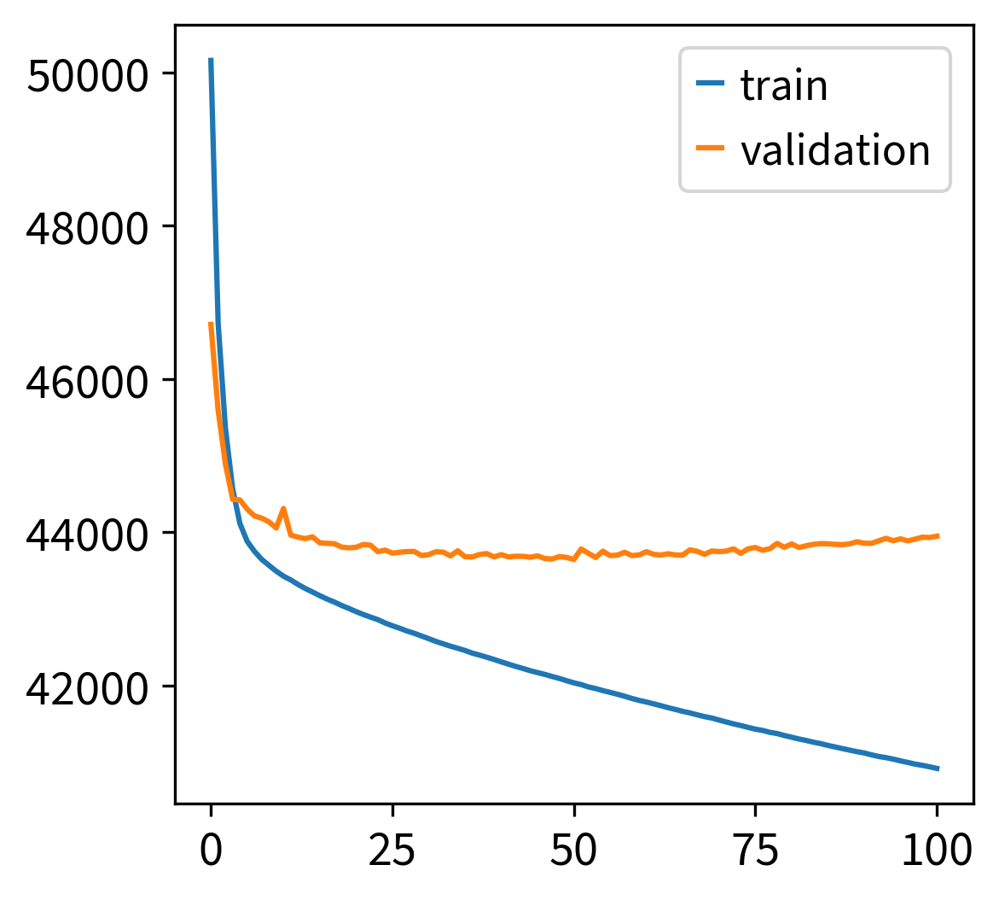

In [25]:
# plot reconstruction loss
plt.plot(model_mvi.history['reconstruction_loss_train']['reconstruction_loss_train'], label='train')
plt.plot(model_mvi.history['reconstruction_loss_validation']['reconstruction_loss_validation'], label='validation')
plt.legend()

## Save

In [26]:
directory_path = '/home/michi/Projects/scMultiome_Mouse-Islets_NVF_E14-E16_Notebooks/Files/Models/'
base_name = 'scMultiome_Mouse-Islets_NVF_E14-E16_MultiVI-Doublet-Removal_v6'
date = str(datetime.date.today()) + '_'

try:
    covarCat = '_covarCat' + ''.join(' '.join('_'.join(categorical_covariate_keys).split('_')).title().split(' '))
except:
    covarCat = '_covarCatNone'
    
try:
    covarCont = '_covarCont' + ''.join(' '.join('_'.join(continuous_covariate_keys).split('_')).title().split(' '))
except:
    covarCont = '_covarContNone' 

# try:
#     labels = '_labels' + ''.join(' '.join(''.join(labels_key).split('_')).title().split(' '))
# except:
#     labels = '_labelsNone'

deep = '_inject' + str(deeply_inject_covariates)
layers = '_layers' + str(n_layers)
hidden = '_hidden' + str(n_hidden)
latent = '_latent' + str(n_latent)

model_type = '_MultiVI'

model_path = ''.join([
    directory_path,
    date,
    base_name,
#     labels,
    covarCat,
    covarCont,
    deep,
    layers,
    hidden,
    latent,
    model_type
])

model_path

'/home/michi/Projects/scMultiome_Mouse-Islets_NVF_E14-E16_Notebooks/Files/Models/2023-12-01_scMultiome_Mouse-Islets_NVF_E14-E16_MultiVI-Doublet-Removal_v6_covarCatStageExperimentBatchSequencingBatch_covarContNone_injectTrue_layers4_hidden1024_latent50_MultiVI'

In [27]:
model_mvi.save(model_path, overwrite=True, save_anndata=True)

## Results

In [28]:
adata_mvi.obsm['X_MultiVI'] = model_mvi.get_latent_representation(adata_mvi)

In [29]:
sc.pp.neighbors(adata_mvi, use_rep='X_MultiVI')

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:16)


In [30]:
sc.tl.umap(adata_mvi, min_dist=0.3)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:10)


In [31]:
sc.tl.leiden(adata_mvi, resolution=1.5)

running Leiden clustering
    finished: found 29 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:03)


/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWa

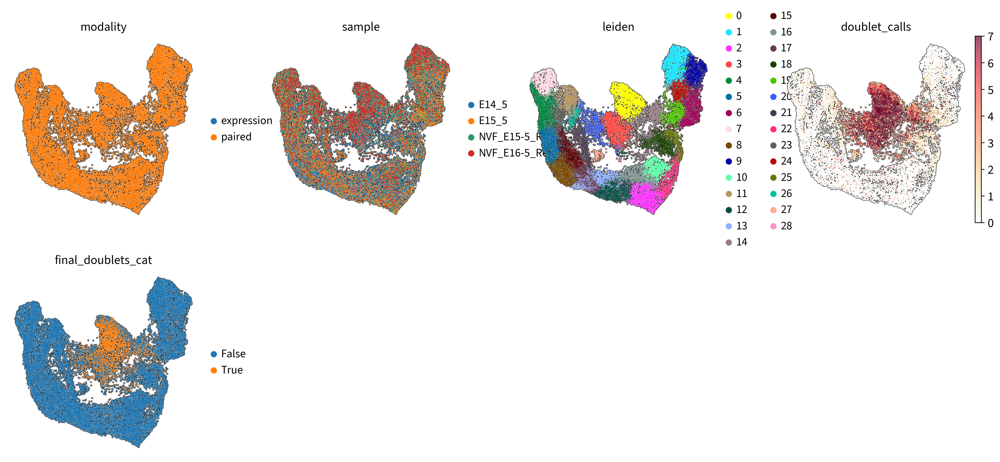

In [32]:
sc.pl.umap(adata_mvi, color=['modality','sample','leiden','doublet_calls','final_doublets_cat'], size=7, add_outline=True, alpha=0.7, outline_width=(0.3, 0.0), ncols=4, color_map=ch_YlRd)

# Remove Doublets

In [34]:
adata_mvi.obs['doublet_calls_cat'] = [str(x) for x in adata_mvi.obs['doublet_calls']]

In [35]:
adata_mvi.uns['doublet_calls_cat_colors'] = np.array([mpl.colors.to_hex(color, keep_alpha=True) for color in ch_YlRd(np.linspace(0,1,8))])

/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


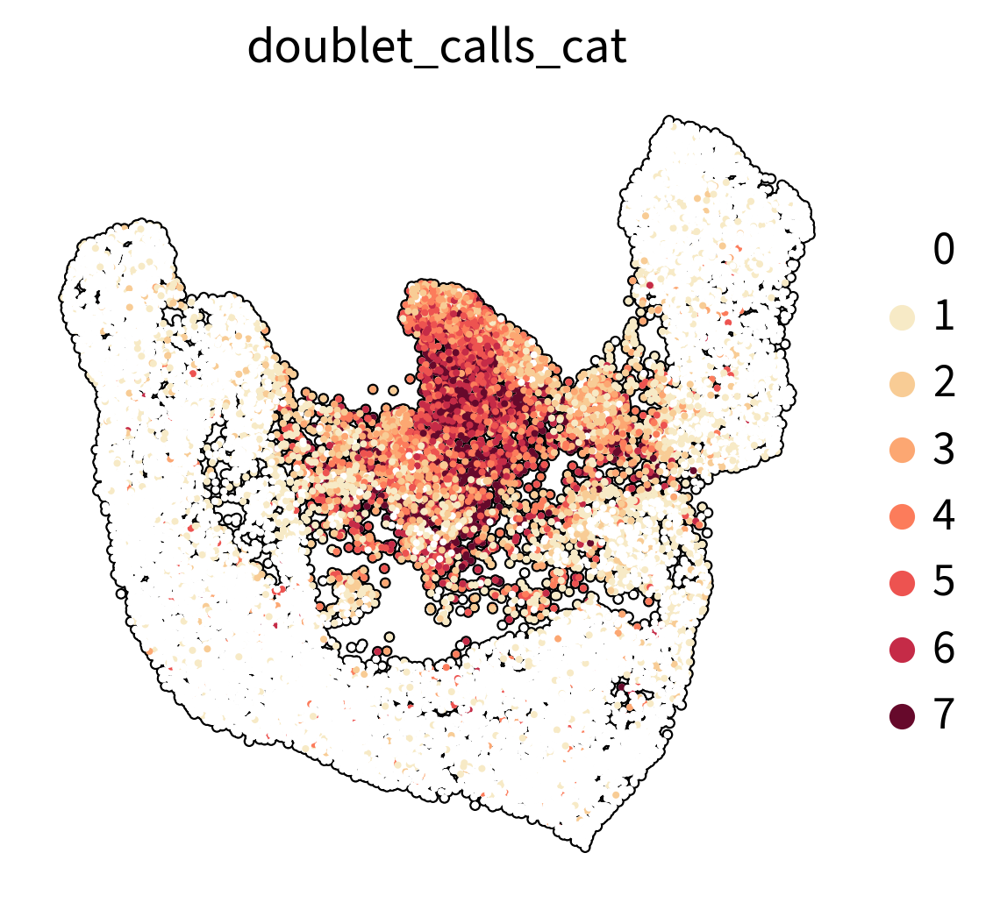

In [36]:
sc.pl.umap(adata_mvi, color=['doublet_calls_cat'], size=15, add_outline=True, alpha=1, outline_width=(0.3, 0.0), ncols=5, color_map=ch_YlRd)

In [37]:
sc.tl.leiden(adata_mvi, resolution=2)

running Leiden clustering
    finished: found 37 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:03)


/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:379

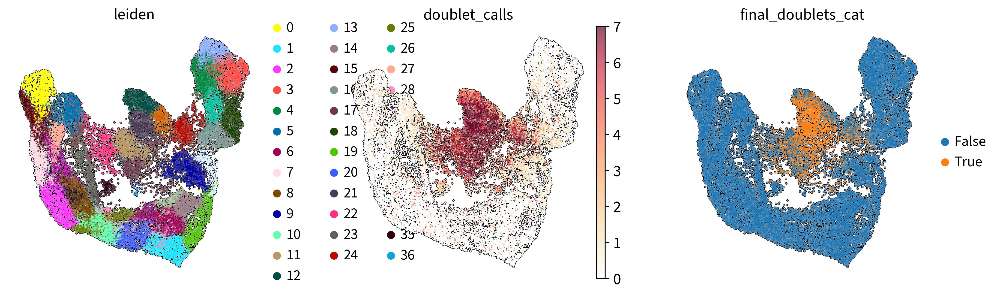

In [38]:
sc.pl.umap(adata_mvi, color=['leiden','doublet_calls','final_doublets_cat'], size=7, add_outline=True, alpha=0.7, outline_width=(0.3, 0.0), ncols=4, color_map=ch_YlRd)

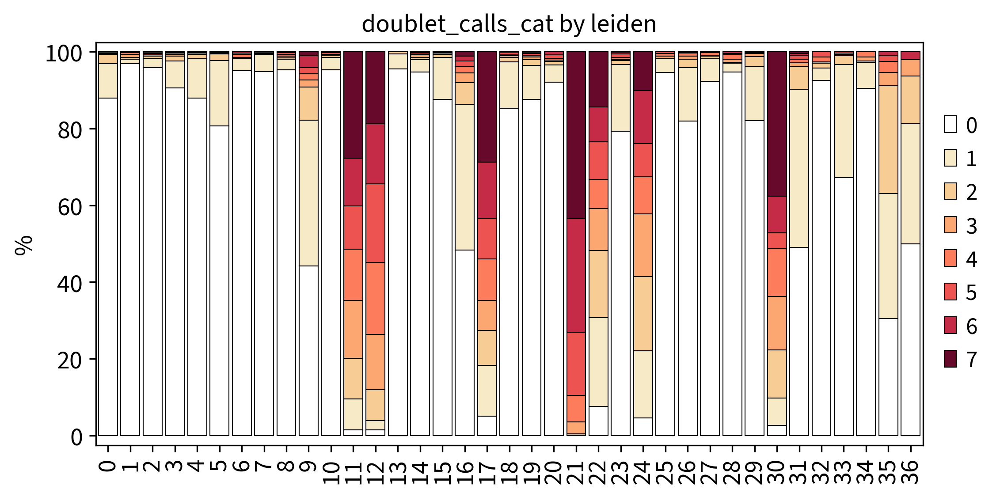

,x_labels,0,1,2,3,4,5,6,7
0,0,87.909516,8.970359,2.496100,0.234009,0.312012,0.078003,0.000000,0.000000
1,1,96.897959,1.142857,0.489796,0.816327,0.489796,0.163265,0.000000,0.000000
2,2,95.901639,2.459016,0.491803,0.327869,0.409836,0.327869,0.000000,0.081967
3,3,90.617284,6.995885,1.316872,0.411523,0.329218,0.246914,0.082305,0.000000
4,4,87.964602,10.176991,1.150442,0.442478,0.088496,0.000000,0.176991,0.000000
5,5,80.748175,16.970803,1.733577,0.273723,0.182482,0.091241,0.000000,0.000000
6,6,95.131086,3.089888,0.187266,0.093633,0.842697,0.374532,0.280899,0.000000
7,7,94.842407,4.489016,0.095511,0.000000,0.191022,0.286533,0.095511,0.000000
8,8,95.317073,2.731707,0.390244,0.390244,0.487805,0.487805,0.097561,0.097561
9,9,44.219067,37.931034,8.620690,1.926978,1.622718,1.622718,3.042596,1.014199


In [39]:
pct_doublets = plot_composition(adata_mvi, x_key='leiden', y_key='doublet_calls_cat', x_rotation=90, figsize=(8,4))
pct_doublets

In [40]:
# remove doublet clusters
adata_mvi = adata_mvi[~adata_mvi.obs.leiden.isin(list(pct_doublets['x_labels'][pct_doublets['0'] < 10]))].copy()

In [41]:
sc.pp.neighbors(adata_mvi, use_rep="X_MultiVI", metric='correlation', n_pcs=50, n_neighbors=20)
sc.tl.umap(adata_mvi, min_dist=0.3)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:07)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:08)


In [42]:
sc.tl.leiden(adata_mvi, resolution=2)

running Leiden clustering
    finished: found 31 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:02)


/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:379

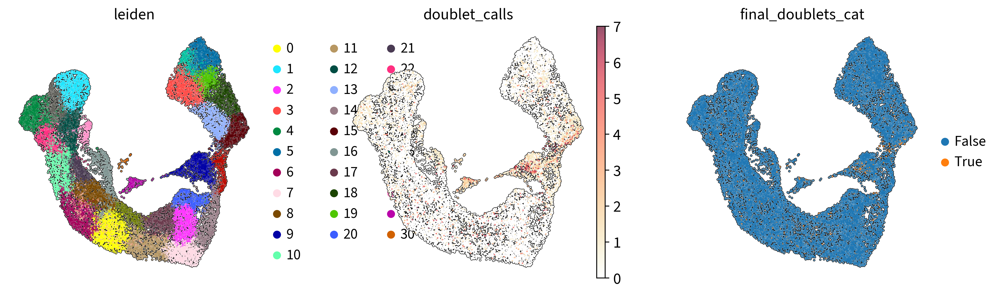

In [43]:
sc.pl.umap(adata_mvi, color=['leiden','doublet_calls','final_doublets_cat'], size=7, add_outline=True, alpha=0.7, outline_width=(0.3, 0.0), ncols=4, color_map=ch_YlRd)

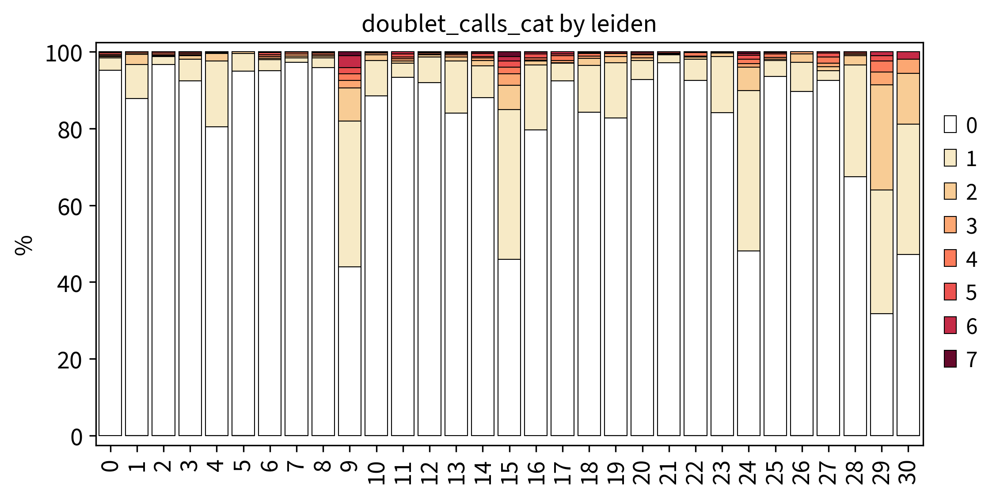

,x_labels,0,1,2,3,4,5,6,7
0,0,95.229983,3.151618,0.340716,0.255537,0.340716,0.511073,0.085179,0.085179
1,1,87.790198,8.942390,2.665520,0.257954,0.343938,0.000000,0.000000,0.000000
2,2,96.742081,1.990950,0.271493,0.271493,0.452489,0.271493,0.000000,0.000000
3,3,92.481203,5.639098,0.845865,0.281955,0.375940,0.281955,0.093985,0.000000
4,4,80.492424,17.140152,1.893939,0.284091,0.094697,0.094697,0.000000,0.000000
5,5,95.004803,4.514890,0.480307,0.000000,0.000000,0.000000,0.000000,0.000000
6,6,95.048544,2.912621,0.388350,0.388350,0.485437,0.582524,0.097087,0.097087
7,7,97.270955,1.169591,0.487329,0.584795,0.389864,0.097466,0.000000,0.000000
8,8,95.833333,2.579365,0.496032,0.297619,0.496032,0.198413,0.000000,0.099206
9,9,43.914807,38.032454,8.620690,1.926978,1.825558,1.622718,3.042596,1.014199


In [44]:
pct_doublets = plot_composition(adata_mvi, x_key='leiden', y_key='doublet_calls_cat', x_rotation=90, figsize=(8,4))
pct_doublets

In [45]:
# remove cells with > 2 doublet calls
adata_mvi = adata_mvi[adata_mvi.obs.doublet_calls < 3 ].copy()

In [46]:
sc.pp.neighbors(adata_mvi, use_rep="X_MultiVI", n_pcs=50, n_neighbors=20)
sc.tl.umap(adata_mvi, min_dist=0.2, spread=0.8, negative_sample_rate=1, gamma=0.5)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:04)


In [47]:
sc.tl.leiden(adata_mvi, resolution=1)

running Leiden clustering
    finished: found 19 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:02)


/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWa

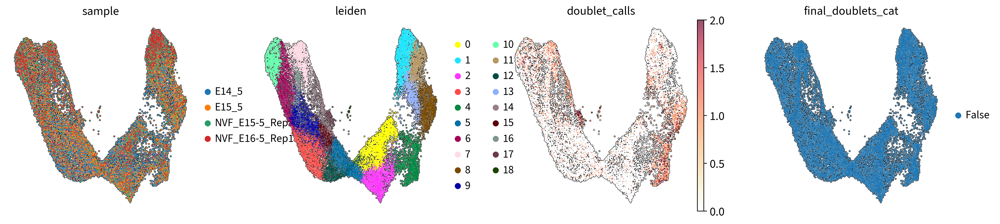

In [48]:
sc.pl.umap(adata_mvi, color=['sample','leiden','doublet_calls','final_doublets_cat'], size=7, add_outline=True, alpha=0.7, outline_width=(0.3, 0.0), ncols=4, color_map=ch_YlRd)

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)
--> added 'pos', the PAGA positions (adata.uns['paga'])


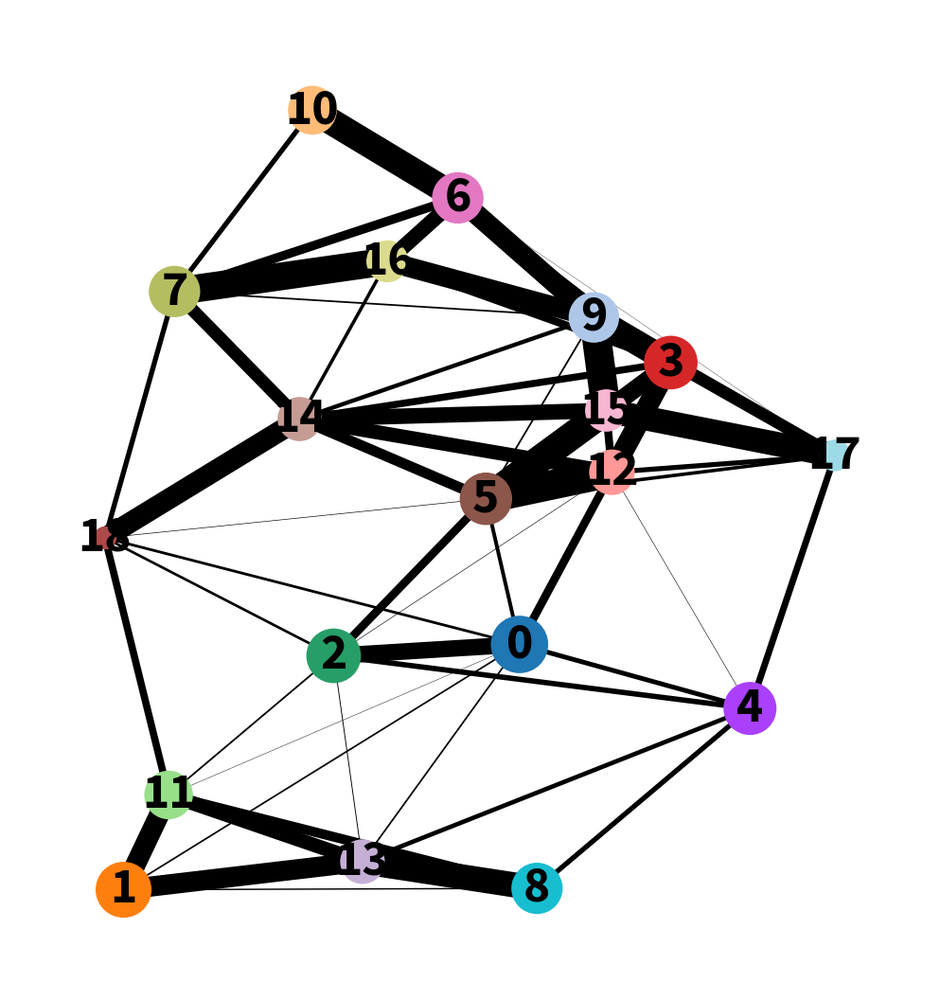

In [49]:
sc.tl.paga(adata_mvi, groups='leiden')
sc.pl.paga(adata_mvi)

In [50]:
sc.tl.umap(adata_mvi, min_dist=0.2, spread=0.8, negative_sample_rate=1, gamma=0.5, init_pos='paga')

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:03)


/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWa

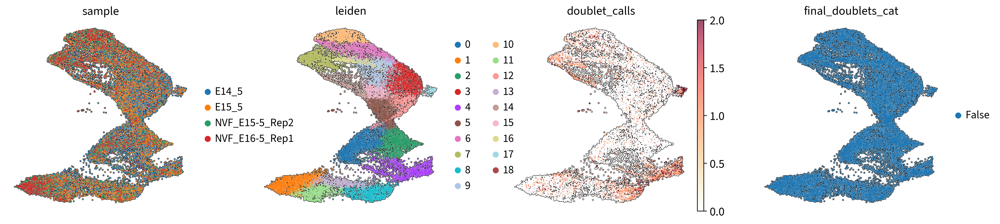

In [51]:
sc.pl.umap(adata_mvi, color=['sample','leiden','doublet_calls','final_doublets_cat'], size=7, add_outline=True, alpha=0.7, outline_width=(0.3, 0.0), ncols=4, color_map=ch_YlRd)

# Update Original Files & Save

In [52]:
barcodes_multiome = [name.split('_')[0] for name in adata_mvi[adata_mvi.obs.modality.isin(['paired'])].obs_names]

In [53]:
mdata = mdata[barcodes_multiome]

In [54]:
adata_multi = adata_multi[barcodes_multiome]
adata_gex = adata_gex[barcodes_multiome]

In [55]:
mdata.obsm['X_MultiVI'] = adata_mvi[adata_mvi.obs.modality.isin(['paired'])].obsm['X_MultiVI']

In [66]:
mdata.write('/home/michi/Projects/scMultiome_Mouse-Islets_NVF_E14-E16_Notebooks/Files/scMultiome_Mouse-Islets_NVF_E14-E16_mdata_markedDoublets_mergedPeaks_normalized_rmDoublets.h5mu')

/home/michi/Software/venvs/scverse_2023_v3/lib/python3.9/site-packages/anndata/_core/anndata.py:1222: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[key] = c
